# GUC NETW 1003 Kmeans Assginmnet 

Objective: exercise is to learn how to use build and use  k-means clustering algorithm    

At the end of this lab you will be able to
> 1. Build and run a K-means algorithm.
> 2. Know how to evaluate K-means Algorithm 
> 2. Understand the effect of the parameters on the performance of the algorithm .
> 3. Understand the effect of distance.

## 1. Wirte K means function 

import required libraries 

In [414]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.datasets import make_moons
from sklearn.preprocessing import RobustScaler

> ### 1.1. Code for the distance function 

write a function to calculate the distance between a set of cluster centroids and all the data points 

Cluster_Distances = GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type) 
* The function should be able to handle data points with any number of features and any number of points 
* The function should be able to handle any K number of cluster centroids 
* To increase speed do that in matrix format using numpy
* This should produce a matrix with rows equal to data points columns equal K 
* You should be able to calculate different types of Distance. In this assignment you are required to implement the following two 
    - Euclidean distance
    - Pearson correlation distance
  

In [453]:
def GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type ):
## write code here for the Distance function here # 
    
    num_of_centroids=Cluster_Centroids.shape[0]
    num_of_data_points=Data_points.shape[0]
    num_of_features=Cluster_Centroids.shape[1]
    Cluster_Distance=np.zeros((num_of_data_points,num_of_centroids))

    ## Euclidean Distance 
    if(Distance_Type == 'euclidean_distance'):
        for i in range(num_of_data_points):
            for j in range(num_of_centroids):
                sum_of_features=0
                for k in range(num_of_features):
                    sum_of_features+= (Data_points.iat[i,k]-Cluster_Centroids.iat[j,k])**2
                Cluster_Distance[i][j]= sum_of_features**0.5   

    ## Pearson Coefficient Distance
    elif(Distance_Type == 'PCD'):
        average_centroids=np.zeros(num_of_centroids)
        average_data=np.zeros(num_of_data_points)

        for i in range(num_of_data_points):
            sum_of_data_features=0
            for k in range(num_of_features):
                sum_of_data_features+=Data_points.iat[i,k]
            average_data[i]=sum_of_data_features/num_of_features

        for j in range(num_of_centroids):
            sum_of_centroid_features=0
            for m in range(num_of_features):
                sum_of_centroid_features+=Cluster_Centroids.iat[j,m]
            average_centroids[j]=sum_of_centroid_features/num_of_features

        for i in range(num_of_data_points):
            for j in range(num_of_centroids):
                sum_all_features_data=0
                sum_all_features_centroid=0
                mult_sum=0
                for k in range(num_of_features):
                    sum_all_features_data+=(Data_points.iat[i,k]-average_data[i])**2
                    sum_all_features_centroid+=(Cluster_Centroids.iat[j,k]-average_centroids[j])**2                    
                    mult_sum+= (Data_points.iat[i,k]-average_data[i]) * (Cluster_Centroids.iat[j,k]-average_centroids[j])

                Cluster_Distance[i][j]=1-(mult_sum/(((sum_all_features_data*sum_all_features_centroid))**0.5))
                
    return Cluster_Distance 




> ### 1.2. Code for K means function 

> Loop until a stopping condition 

> > in the loop do the following 
> > 1. Cluster Assignmnet 
> > > * Use the GUC_Distance to calculate between each cluster head and all the points 
> > > * Find the value and index of the minimum distance  for each row. 
> > > * for each point in the row use the index of the minimum distance to represent the cluster Centroid that this point will belong to.
> > > * Calculate and record the mean square distance for each cluster  
> > > * Use the mean square distances to calculate a stopping condition (e.g the sum of mean distances)
> > 2. Update Centroids  
> > > * Update the value for the cluster heads by calculating the mean value for the points in each cluster 
> > >  * Calculate the Cluster Metric (Distortion Function)
> > > > a number indicating the how good the clusters are . An example cluster metric is the  (sum of squared error between each point and its cluster center) 

In [464]:
def GUC_Kmean ( Data_points, Number_of_Clusters,  Distance_Type ):
   # write code for initial cluster heads here 
  num_of_points,num_of_features=Data_points.shape
  # Aggregate computes minimum and maximum for all features in the data_points DataFrame
  feature_ranges = Data_points.aggregate([min, max])
  # Creates a DataFrame for the centroids with the same column names as the Data_points
  Cluster_Centroids = pd.DataFrame(columns=Data_points.columns)
  for feature in Data_points.columns:
      min_val = feature_ranges.loc['min', feature]
      max_val = feature_ranges.loc['max', feature]
      Cluster_Centroids[feature] = np.random.uniform(min_val, max_val, size=Number_of_Clusters)

   # write your your loop 
  index = np.zeros(num_of_points, dtype=int)
  min_dist = np.zeros(num_of_points, dtype=float)
  Final_Cluster_Distance = np.zeros(Number_of_Clusters, dtype=float)
  mean_error = np.zeros(Number_of_Clusters, dtype=float)
  previous_centroids = pd.DataFrame(np.nan, index=np.arange(Number_of_Clusters), columns=Data_points.columns)
  Cluster_Metric=100
  sum_mean=50
  if(Distance_Type=='PCD'):
     condition=0.000001
  else: condition=0.01
  while (not Cluster_Centroids.equals(previous_centroids)) and (abs(Cluster_Metric-sum_mean)>condition) :
     #The sorted_points list contains one empty list for each centroid, where data points are appended once they’ve been assigned.
     sorted_points = [[] for _ in range(Number_of_Clusters)]
     cluster_distances = [[] for _ in range(Number_of_Clusters)]
     distances=GUC_Distance(Cluster_Centroids,Data_points,Distance_Type)
     row, column = distances.shape
     tolerance=1e-9
     for i in range(row):
        min_dist[i]=distances[i][0]
        index[i]=0
        for j in range(column):
           if((distances[i][j]<min_dist[i]) and (abs(distances[i][j]-min_dist[i])>tolerance)):
              min_dist[i]=distances[i][j]
              index[i]=j
        sorted_points[index[i]].append(Data_points.iloc[i])
        cluster_distances[index[i]].append(min_dist[i])
     Cluster_Metric=0
     sum_mean=0
     for k in range(Number_of_Clusters):
         if cluster_distances[k]:
            Final_Cluster_Distance[k] = np.mean(np.square(cluster_distances[k]))
            mean_error[k] = np.mean(cluster_distances[k])
            Cluster_Metric+= Final_Cluster_Distance[k]
            sum_mean+= mean_error[k] 
     previous_centroids = Cluster_Centroids.copy()
     for k, cluster in enumerate(sorted_points):
      if len(cluster) > 0:
        centroid = np.mean(cluster, axis=0) 
        Cluster_Centroids.iloc[k] = centroid

  return [ Cluster_Centroids,index,Final_Cluster_Distance , Cluster_Metric ]    


## 2. Display Results 

* below is a an example fuction that displayes Clusters in 2D 

* You need to change the function so that is can display an n dimension data in the form of pairs of subplot 2D figures 

* The function is a helper function that is originaly be found in 
https://www.coursera.org/learn/ibm-unsupervised-learning/


In [3]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt

> #### 2.1. helper Display function 

In [434]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X, data_clusters=[], cluster_centroids=[], num_clusters=0):
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'orange', 'olive', 'gray']  # List of colors
    alpha = 0.5  # Color opacity
    s = 20  # Size of points
    
    num_dimensions = X.shape[1]
    
    if num_dimensions == 2:
        fig, ax = plt.subplots(figsize=(6, 6))
        if num_clusters == 0:
            ax.scatter(X.iloc[:, 0], X.iloc[:, 1], c=color[0], alpha=alpha, s=s)
        else:
            for i in range(num_clusters):
                ax.scatter(X[data_clusters == i].iloc[:, 0], X[data_clusters == i].iloc[:, 1], c=color[i], alpha=alpha, s=s)
                ax.scatter(cluster_centroids.iloc[i, 0], cluster_centroids.iloc[i, 1],c=color[i], marker='x', s=100)
        ax.set_xlabel('Feature 1')
        ax.set_ylabel('Feature 2')
    else:
        feature_pairs = [(col1, col2) for col1 in X.columns for col2 in X.columns if col1 != col2]
        num_pairs = len(feature_pairs)
        if num_pairs % 2 == 1:
            rows = (num_pairs // 2) + 1
        else:
            rows = num_pairs // 2
        
        fig, axs = plt.subplots(rows, 2, figsize=(20, rows * 3), sharex=False, sharey=False)
        
        for idx, pair in enumerate(feature_pairs):
            row = idx // 2
            col = idx % 2
            if num_clusters == 0:
                axs[row, col].scatter(X[pair[0]], X[pair[1]], c=color[0], alpha=alpha, s=s)
            else:
                for i in range(num_clusters):
                    axs[row, col].scatter(X[data_clusters == i][pair[0]], X[data_clusters == i][pair[1]],c=color[i], alpha=alpha, s=s)
                    axs[row, col].scatter(cluster_centroids.iloc[i][pair[0]], cluster_centroids.iloc[i][pair[1]],c=color[i], marker='x', s=100)
            axs[row, col].set_xlabel(pair[0])
            axs[row, col].set_ylabel(pair[1])

        if num_pairs % 2 == 1:
            fig.delaxes(axs[-1, -1])

    plt.tight_layout()
    plt.show()


> #### 2.2. Example 1 : Circular Data Gen and display 

* below is an example of how to use the function 
  *  prepare the figure size and background 
   > * this part can be replaced by a number of subplots 
  
  * Produce a data set that represent the x and y coordinates of a circle 
   > * this part can be replaced by data that you import from a file 
  
  * Data is displayed 
   > * to display the data only it is assumed that the number of clusters is zero which is the default of the function 

2


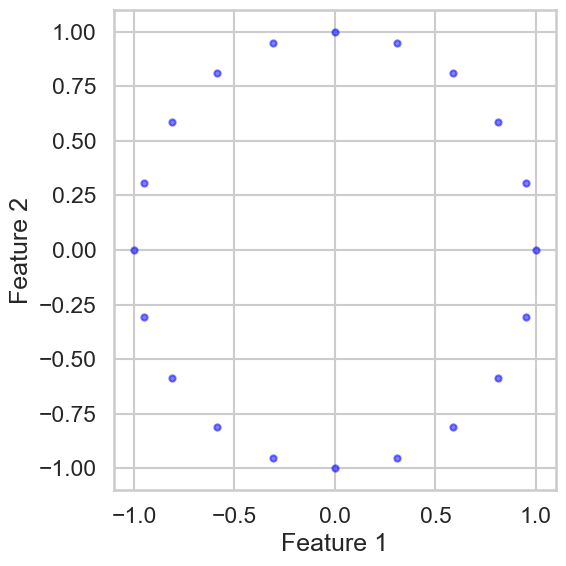

In [204]:
# prepare the figure size and background 
# this part can be replaced by a number of subplots 
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y coordinates of a circle 
# this part can be replaced by data that you import from a file 
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X1 = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed 
# to display the data only it is assumed that the number of clusters is zero which is the default of the function 
display_cluster(X1)

> #### 2.3. Example 2 : Multi blob Data Gen and display 

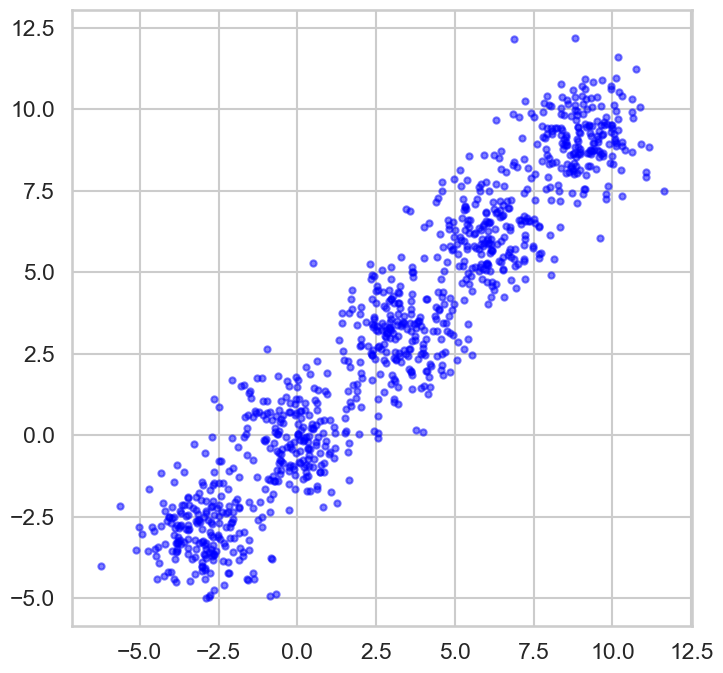

In [271]:
n_samples = 1000
n_bins = 4  
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X2, y = blobs = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
display_cluster(X2)

#### 2.3. Example 3 : moons Data Gen and display 

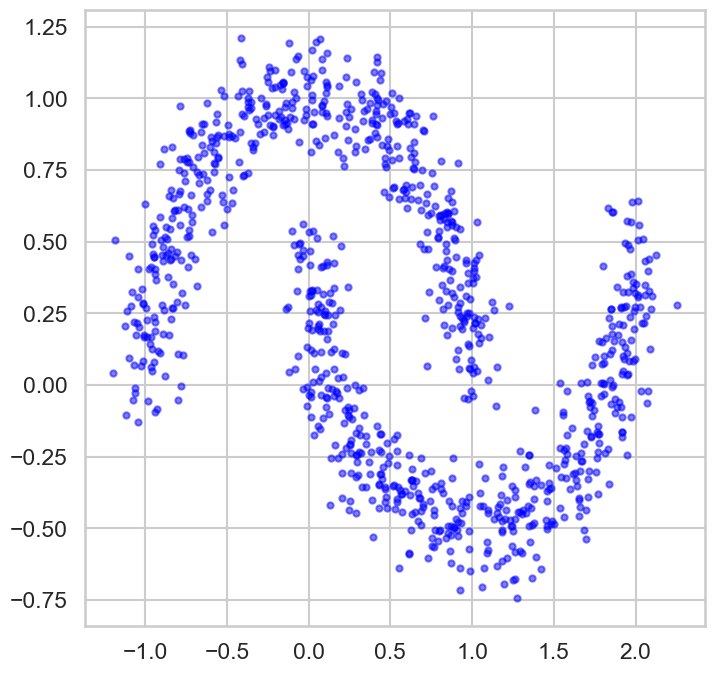

In [284]:
n_samples = 1000
X3, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
display_cluster(X3)

## 3. Testing the GUC_Kmean function on Simple 2D
1. Apply the GUC_Kmean fucntion to 2D Data provided by example 1, Example 2 and Example 3
2. Try a varing number of cluster centriods that range from 2 to 10 clusters on each set 
3. Display your results.
4. plot the Cluster perfromance Metric versus the number of clusters
4. Change the distance function and repeat the above steps 

<Figure size 800x800 with 0 Axes>

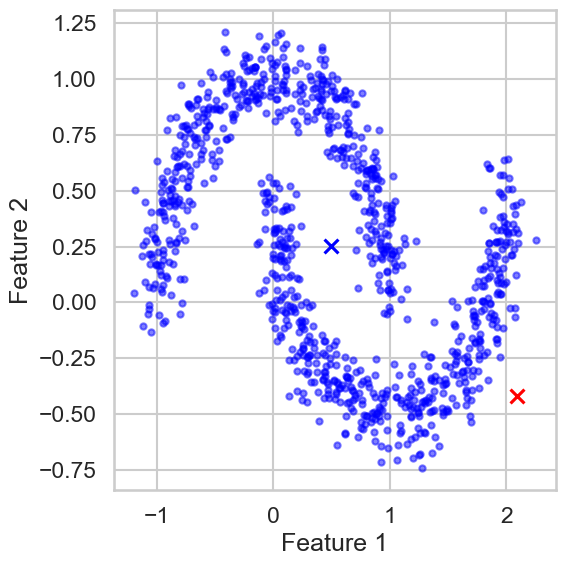

<Figure size 800x800 with 0 Axes>

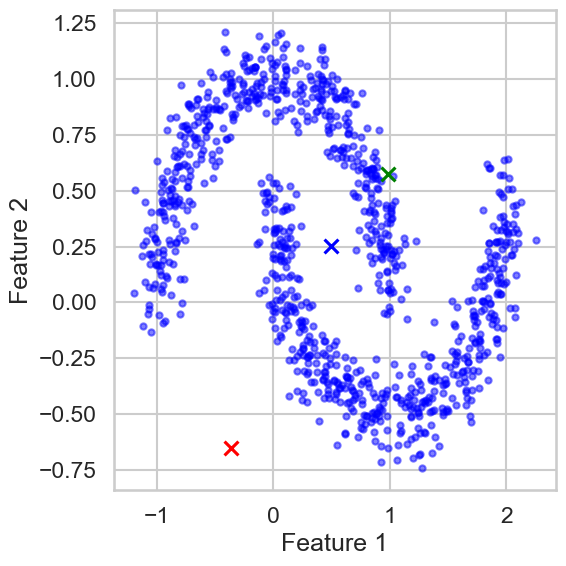

<Figure size 800x800 with 0 Axes>

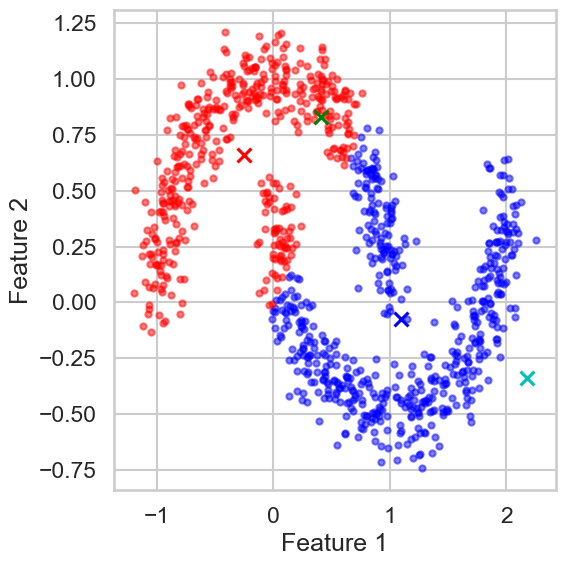

<Figure size 800x800 with 0 Axes>

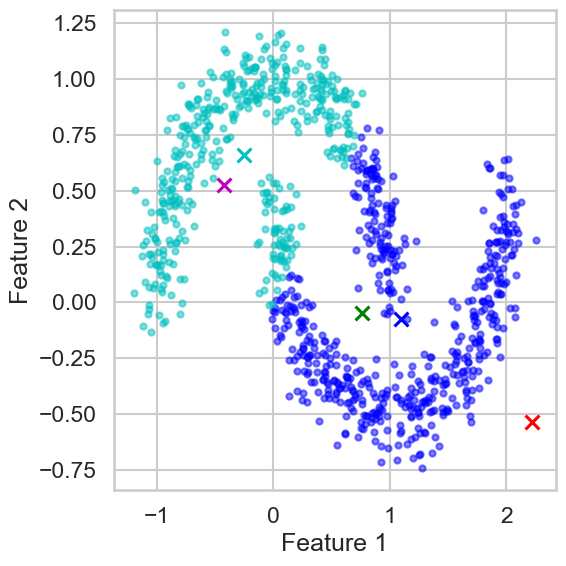

<Figure size 800x800 with 0 Axes>

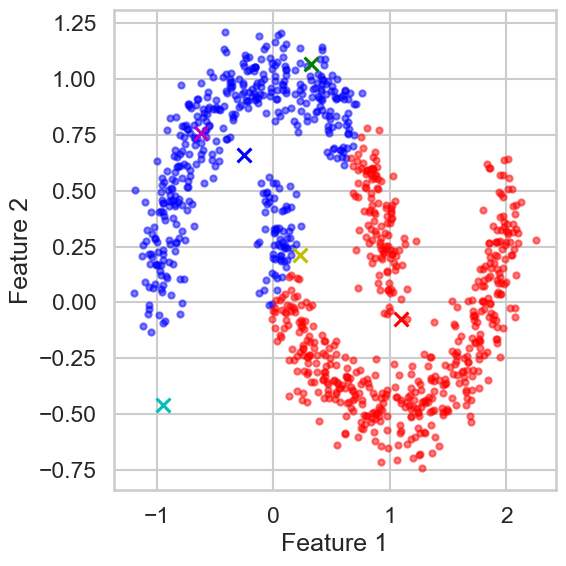

<Figure size 800x800 with 0 Axes>

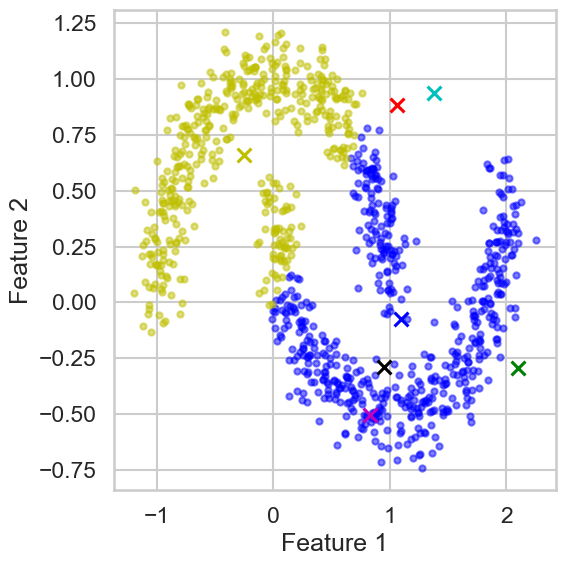

<Figure size 800x800 with 0 Axes>

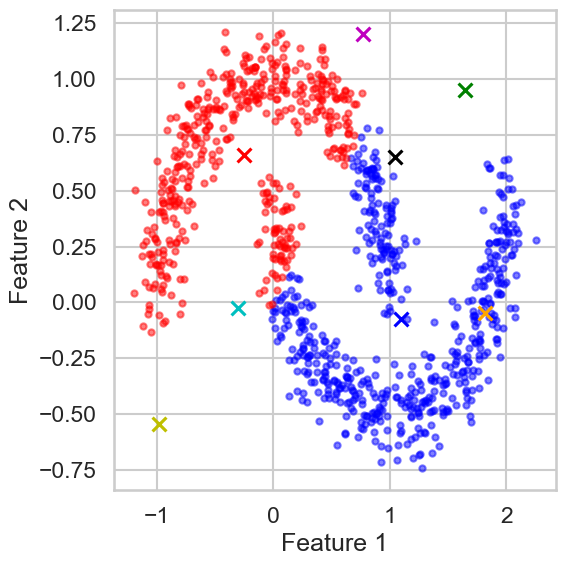

<Figure size 800x800 with 0 Axes>

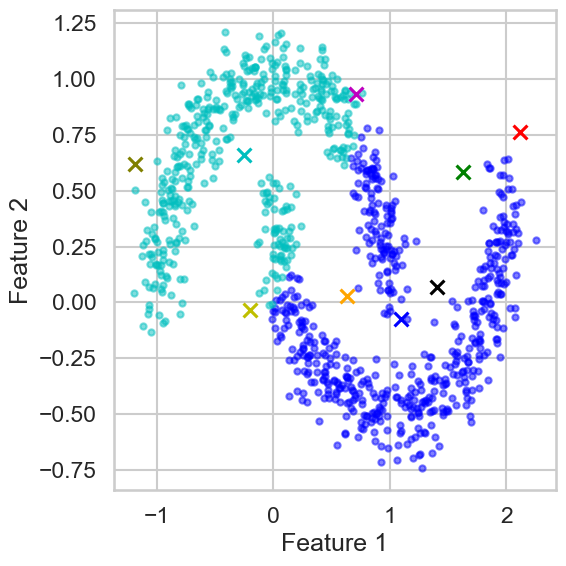

<Figure size 800x800 with 0 Axes>

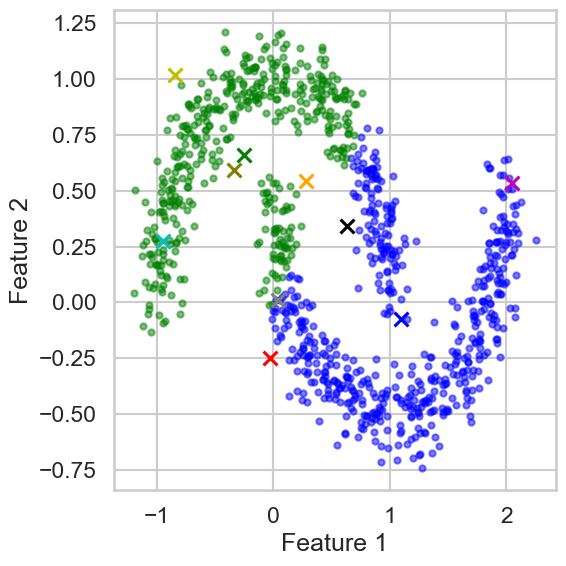

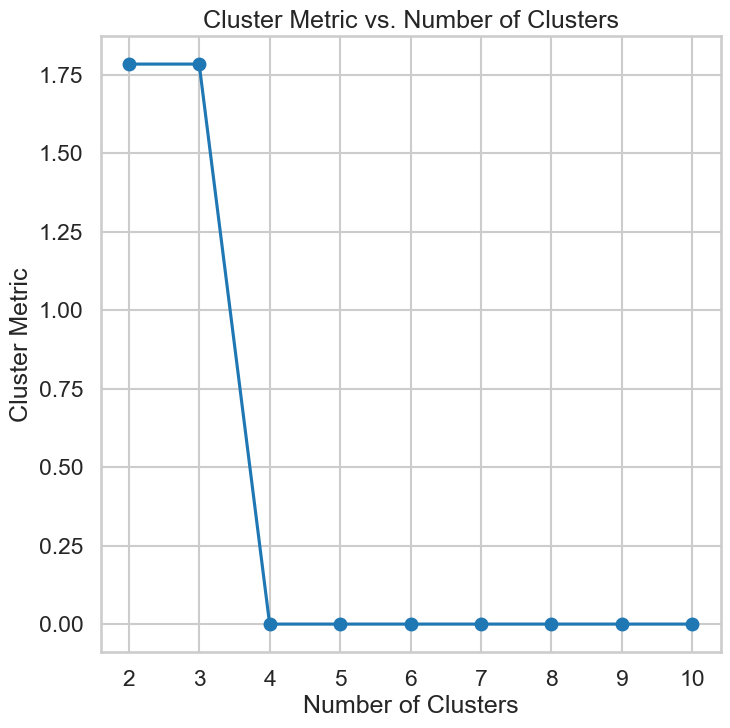

In [489]:
def plots_2Dexamples(X,Distance_type):

    #scaler = RobustScaler()
    #scaled_data = scaler.fit_transform(X)
    df = pd.DataFrame(X, columns=['Feature1', 'Feature2'])

    ex1_clusterMetric=np.zeros(9)

    for i in range(9):
        Cluster_centroids,data_center_indices,Final_Cluster_Distance , Cluster_Metric=GUC_Kmean(df,i+2, Distance_type)
        ex1_clusterMetric[i]=Cluster_Metric
        plt.figure()
        display_cluster(df,data_center_indices,Cluster_centroids,i+2)

    plt.figure()
    x_values = range(2, 11) 
    y_values = ex1_clusterMetric

    plt.plot(x_values, y_values, marker='o', linestyle='-')

    plt.xlabel('Number of Clusters')
    plt.ylabel('Cluster Metric')
    plt.title('Cluster Metric vs. Number of Clusters')
    plt.show()

# Choose from X1, X2 and X3
# Distances are either 'euclidean_distance' or 'PCD'
plots_2Dexamples(X3,'PCD')



## 4. Using the GUC_Kmean function to segment customers int he provided customer dataset
1. Apply the GUC_Kmean fucntion to customer data  
2. Try a varing number of cluster that range from 2 to 10 cluster on each set 
3. Display your results.
4. plot the Cluster Metric versus the number of clusters
4. Change the distance function and repeat the above steps 

<Figure size 800x800 with 0 Axes>

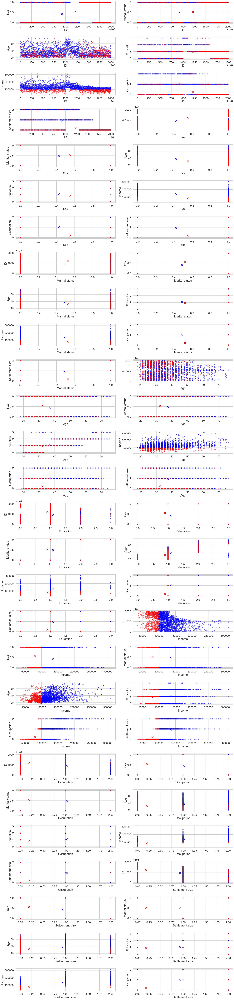

<Figure size 800x800 with 0 Axes>

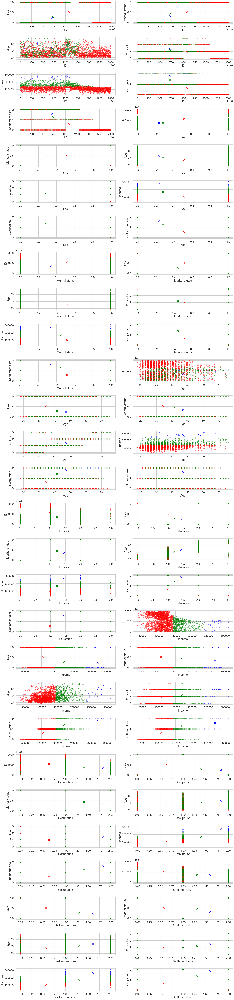

<Figure size 800x800 with 0 Axes>

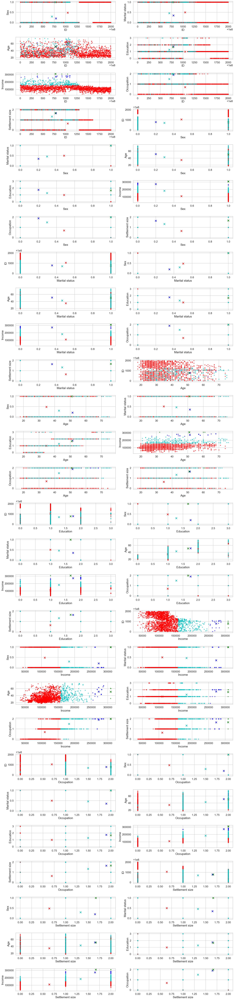

<Figure size 800x800 with 0 Axes>

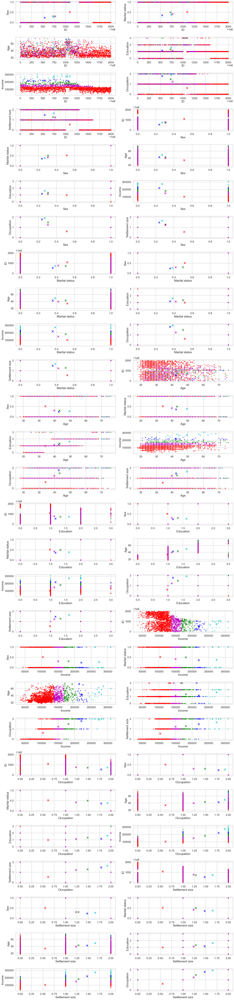

<Figure size 800x800 with 0 Axes>

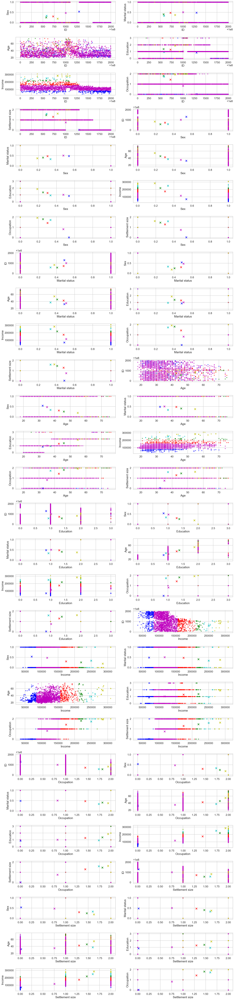

<Figure size 800x800 with 0 Axes>

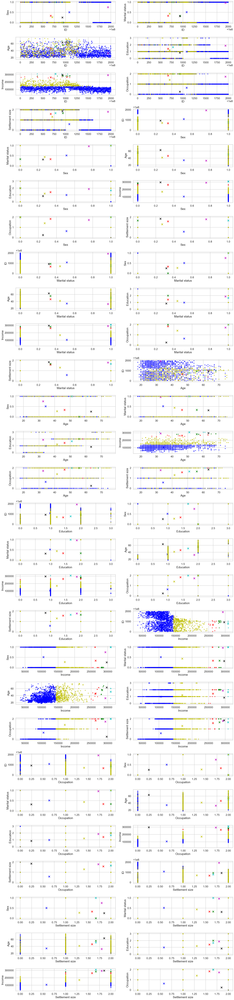

<Figure size 800x800 with 0 Axes>

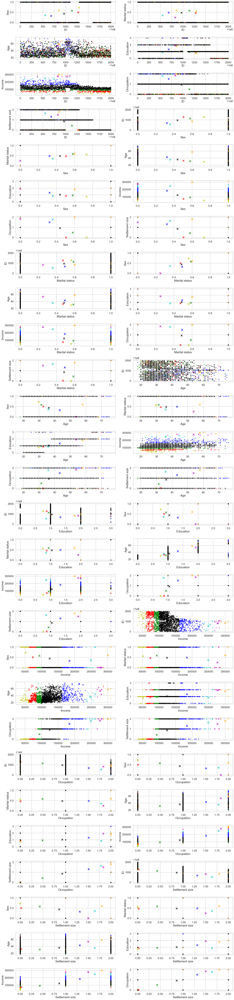

<Figure size 800x800 with 0 Axes>

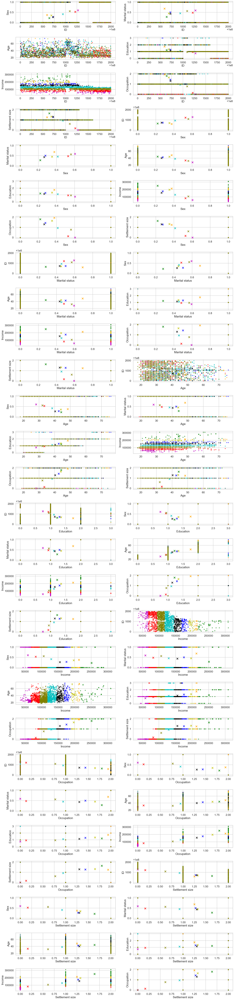

<Figure size 800x800 with 0 Axes>

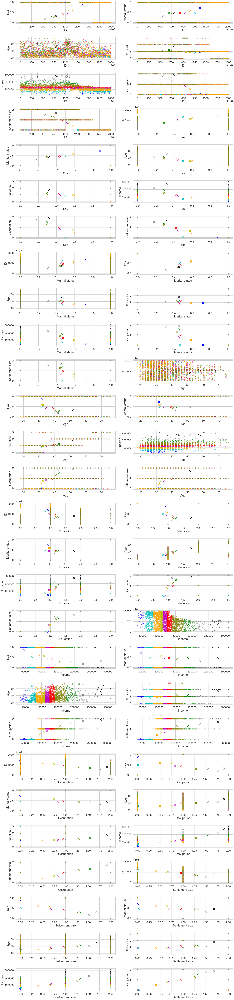

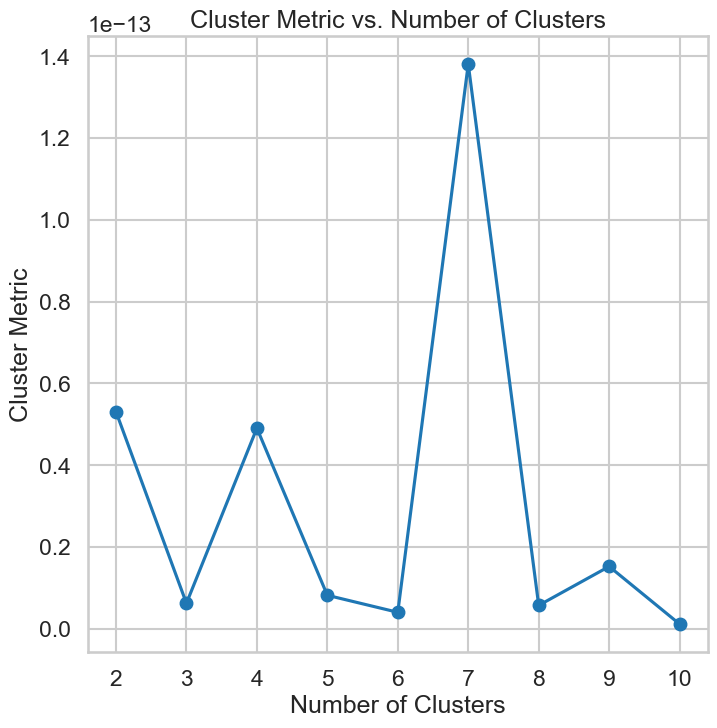

In [488]:
def plots_dataset(X,Distance_type):
    #scaler = RobustScaler()
    #scaled_data = scaler.fit_transform(X)
    df = pd.DataFrame(X)  ## X or scaled_data based on whether normalized is needed or not

    ex1_clusterMetric=np.zeros(9)

    for i in range(9):
        Cluster_centroids,data_center_indices,Final_Cluster_Distance , Cluster_Metric=GUC_Kmean(df,i+2, Distance_type)
        ex1_clusterMetric[i]=Cluster_Metric
        plt.figure()
        display_cluster(df,data_center_indices,Cluster_centroids,i+2)

    plt.figure()
    x_values = range(2, 11)  
    y_values = ex1_clusterMetric


    plt.plot(x_values, y_values, marker='o', linestyle='-')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Cluster Metric')
    plt.title('Cluster Metric vs. Number of Clusters')
    plt.show()



# Choose from X1, X2 and X3
# Distances are either 'euclidean_distance' or 'PCD'
dataset = pd.read_csv("Customer_data.csv")
plots_dataset(dataset,'PCD')


# df = pd.DataFrame(dataset)
# Cluster_centroids,data_center_indices,Final_Cluster_Distance , Cluster_Metric=GUC_Kmean(df,3, 'euclidean_distance')
# display_cluster(df,data_center_indices,Cluster_centroids,3)


